# Bring Relevant Clusters on TSNE

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn import metrics
from PIL import Image

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

import IPython.display as ipd

In [2]:
save_dpath = '/projects/MultiActiveAI/Samir_VICReg_Outputs/tsne_outputs_final'
df = pd.read_csv (os.path.join(save_dpath, 'Data.csv'))

df

,Unnamed: 0,detection,confidence,year,month,day,hour,minute,second,week,weekday,device,set,x,y,labels,paths
0,0,No detection,1.000000,2021,6,7,5,29,42,23,1,23764,set1,55.911781,53.082493,80,set1/00023764/20210607_STUDY/20210607T050000+0...
1,1,No detection,1.000000,2021,8,18,0,19,0,33,3,23795,set3,62.338558,-100.753777,812,set3/00023795/20210817_STUDY/20210817T234600-0...
2,2,Common Yellowthroat,0.101613,2021,5,31,10,17,42,22,1,23764,set1,86.365318,78.219185,0,set1/00023764/20210531_STUDY/20210531T100000+0...
3,3,Indigo Bunting,0.445978,2021,5,31,10,17,42,22,1,23764,set1,86.365318,78.219185,0,set1/00023764/20210531_STUDY/20210531T100000+0...
4,4,No detection,1.000000,2021,8,20,4,10,25,33,5,4879,set3,29.915009,-104.473923,398,set3/00004879/20210819_STUDY/20210819T234549-0...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206000,206000,Blackburnian Warbler,0.119140,2021,8,13,3,11,9,32,5,23734,set3,-7.442607,-130.941910,136,set3/00023734/20210813_STUDY/20210813T030845-0...
206001,206001,Indigo Bunting,0.272019,2021,7,6,8,4,4,27,2,23734,set1,-71.991364,-21.429605,618,set1/00023734/20210706_STUDY/20210706T063149-0...
206002,206002,No detection,1.000000,2021,6,20,23,5,15,24,7,23764,set1,42.511147,87.052155,142,set1/00023764/20210620_STUDY/20210620T230000+0...
206003,206003,Indigo Bunting,0.629860,2021,7,6,10,5,59,27,2,23734,set1,-83.632874,-15.461312,98,set1/00023734/20210706_STUDY/20210706T095444-0...


Text(0.5, 1.0, 'Bird detections')

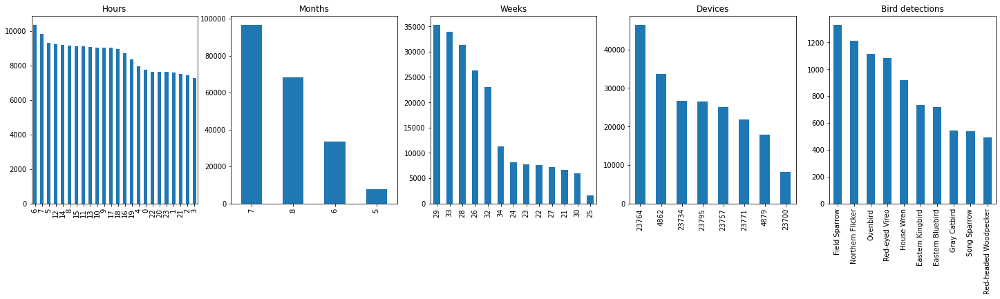

In [3]:
fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(25, 5))
#df.labels.value_counts()[0:10].plot.bar(ax=axes[0])
df.hour.value_counts().plot.bar(ax=axes[0])
df.month.value_counts().plot.bar(ax=axes[1])
df.week.value_counts().plot.bar(ax=axes[2])
df.device.value_counts().plot.bar(ax=axes[3])
df.detection.value_counts()[20:30].plot.bar(ax=axes[4])

axes[0].set_title("Hours")
axes[1].set_title("Months")
axes[2].set_title("Weeks")
axes[3].set_title("Devices")
axes[4].set_title("Bird detections")

#axes[0].set_title("Birds on cluster number " + str(label))


In [4]:
df=df[df['confidence']>0.0]
clusters=[]
for label in np.unique(df['labels']):
    aux1 = {}
    aux=df[df['labels']==label]
    bird_detection_rate = aux[aux['detection']!='No detection'].size/aux.size
    aux1['label']=label
    aux1['detection_rate']=bird_detection_rate
    clusters.append(aux1)

clusters = pd.DataFrame(data=clusters)

<AxesSubplot:>

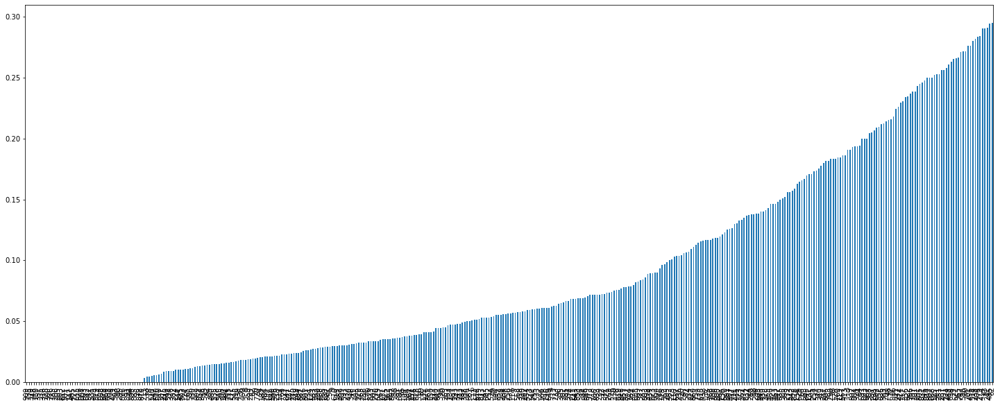

In [14]:
relevant_clusters = clusters[clusters['detection_rate']<0.999]
relevant_clusters = relevant_clusters[relevant_clusters['detection_rate']<0.3]
relevant_clusters = relevant_clusters.sort_values('detection_rate')
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(25, 10))
relevant_clusters.detection_rate.plot.bar(ax=axes)

In [15]:
unique_labels=np.unique(relevant_clusters['label'])
relevant_clusters.shape[0]

402

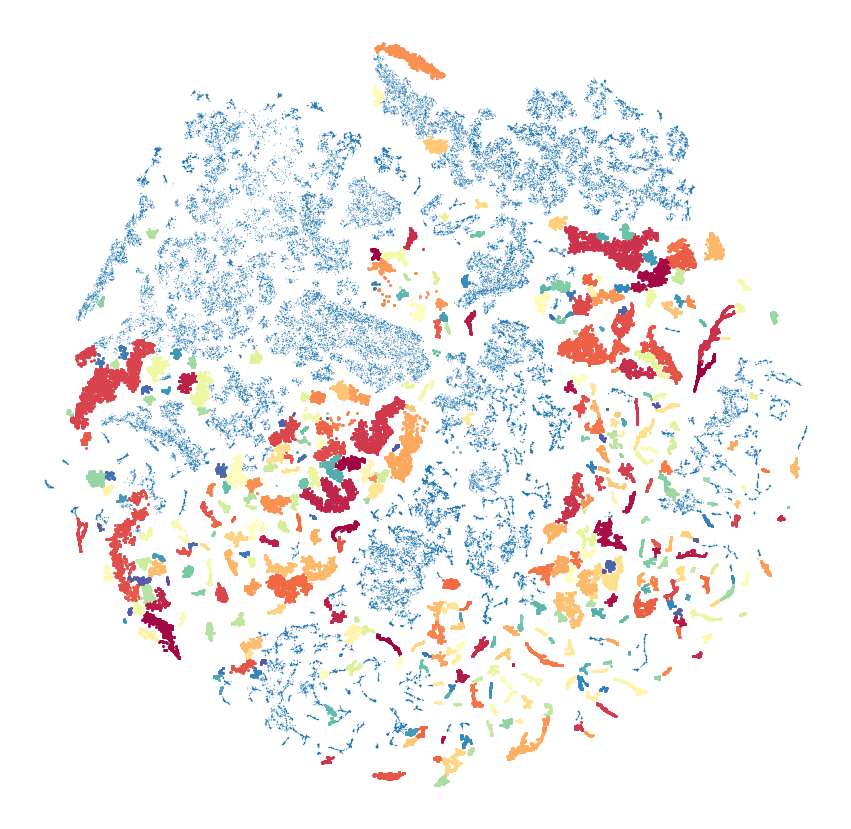

In [16]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot()
ax.scatter(df['x'],df['y'],s=0.01)
patches=[]
colors = [plt.cm.Spectral(each) for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    samples = df[df['labels']==k]
    ax.plot(
        samples['x'],
        samples['y'],
        "o",
        markerfacecolor=tuple(col),
        markeredgecolor=col,
        markersize=2,
    )
    
    patch = mpatches.Patch(color=col, label=k)
    patches.append(patch)
    
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

ax.set_xticks([])
ax.set_yticks([])

fig.set_size_inches(15, 15)

# plt.savefig("bird_detection_greater_than_0.7.png", dpi=300)
# plt.savefig("bird_detection_less_than_0.3.png", dpi=300)

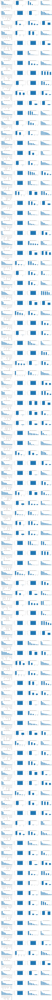

In [8]:
nrows=100
fig, axes = plt.subplots(nrows=nrows, ncols=4, figsize=(25, nrows*5))
for k, label in enumerate(unique_labels):
    if k < nrows:
        samples = df[df['labels']==label]
        #samples = samples[samples['confidence']>0.5]
        #samples = samples[samples['detection']!='No detection']
        #print(k)
        #print(label)
        samples.detection.value_counts()[0:10].plot.bar(ax=axes[k, 0])
        samples.device.value_counts().plot.bar(ax=axes[k,1])
        samples.week.value_counts().plot.bar(ax=axes[k,2])
        samples.hour.value_counts().plot.bar(ax=axes[k,3])

        
        axes[k, 0].set_title("Birds on cluster number " + str(label))
        axes[k, 1].set_title("Devices on cluster number " + str(label))
        axes[k, 2].set_title("Weeks on cluster number " + str(label))
        axes[k, 3].set_title("Hours on cluster number " + str(label))

fig.subplots_adjust(hspace=1.50)

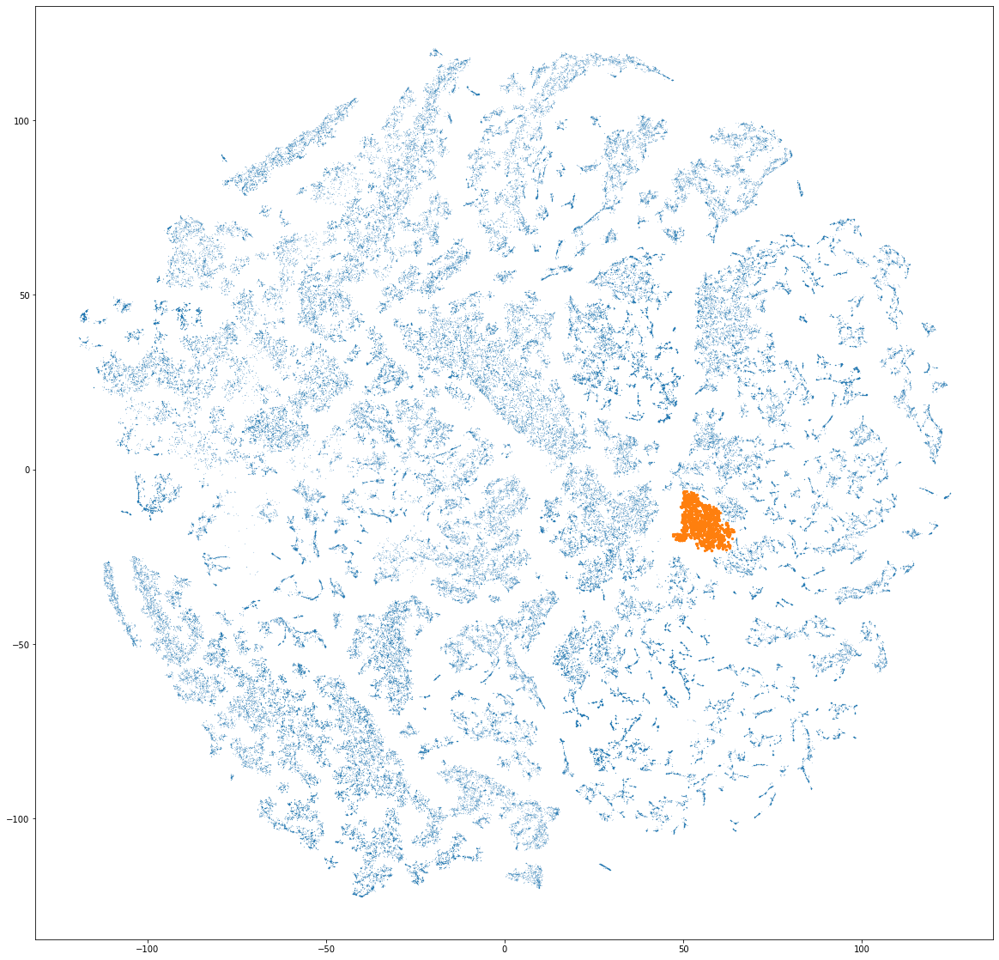

In [13]:
cluster=4
samples=df[df['labels']==cluster]
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot()
ax.scatter(df['x'],df['y'],s=0.01)
ax.scatter(samples['x'],samples['y'],s=5)

fig.set_size_inches(20, 20)

Chimney Swift
0.34856424


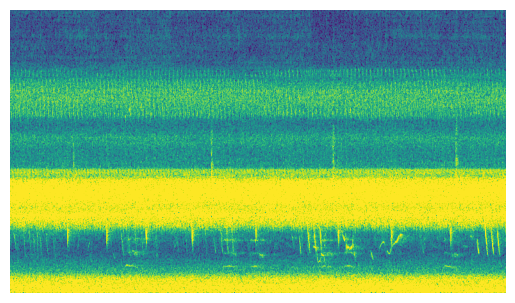

American Goldfinch
0.28862953


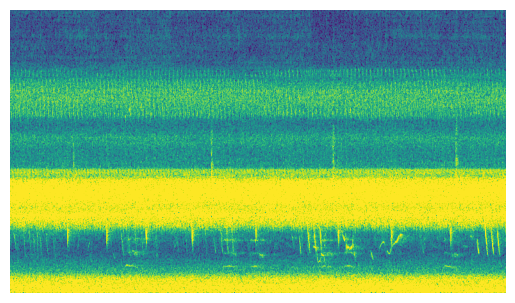

Eastern Phoebe
0.14095615


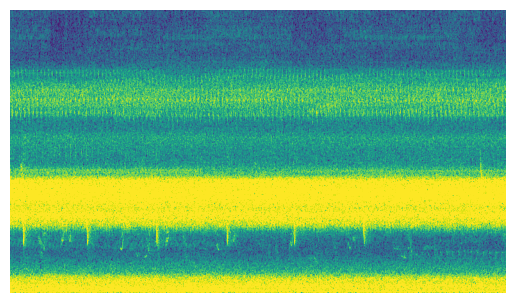

Eastern Phoebe
0.17388399


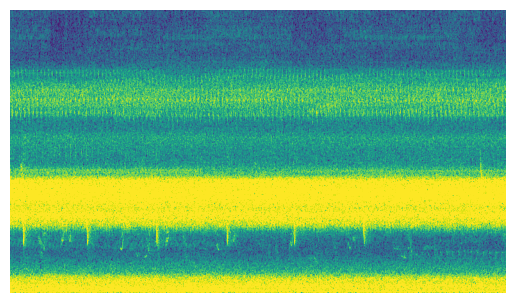

No detection
1.0


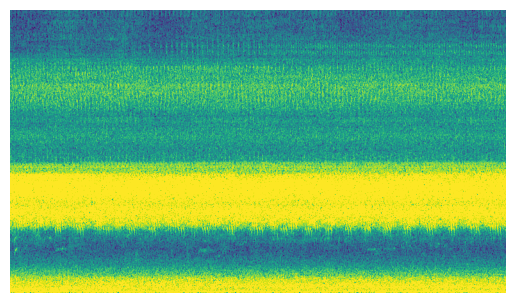

No detection
1.0


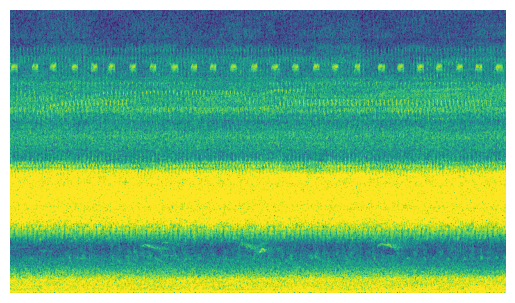

No detection
1.0


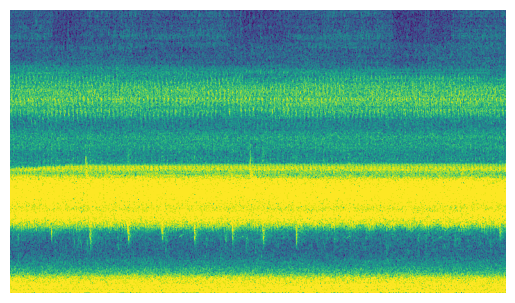

House Finch
0.31380695


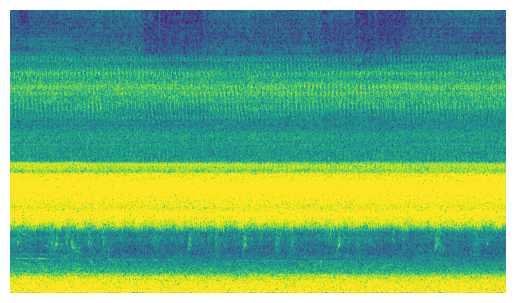

House Sparrow
0.13917984


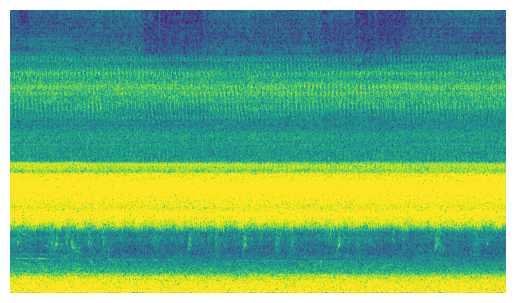

No detection
1.0


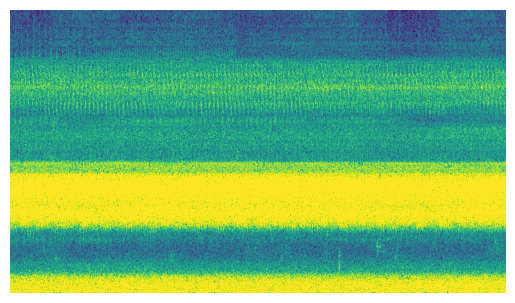

American Goldfinch
0.18251781


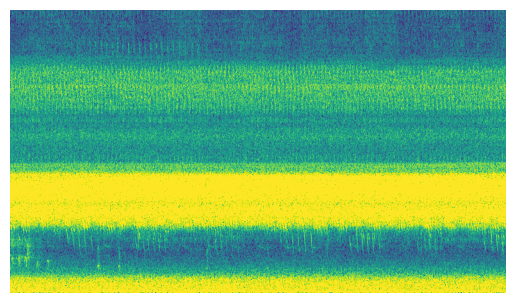

Red-eyed Vireo
0.19572115


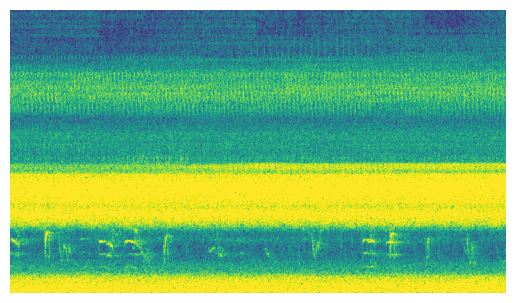

Scarlet Tanager
0.11543218


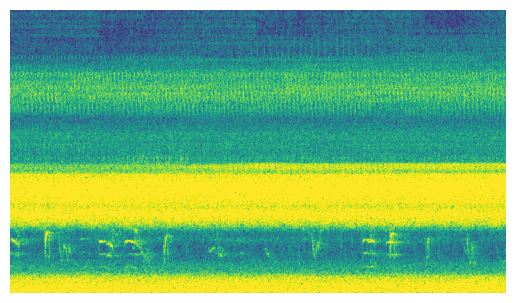

No detection
1.0


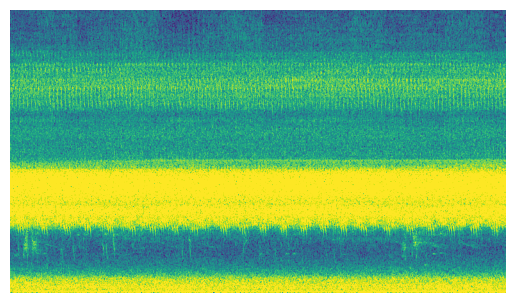

No detection
1.0


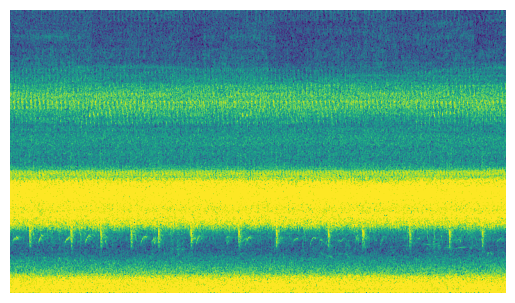

Blue Jay
0.8041962


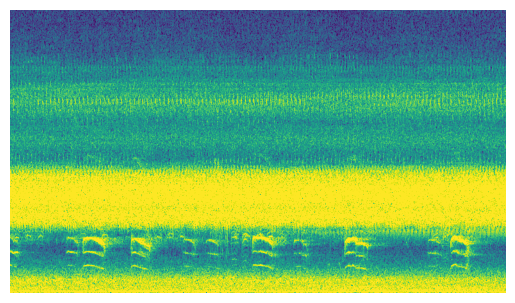

Blue Jay
0.4420094


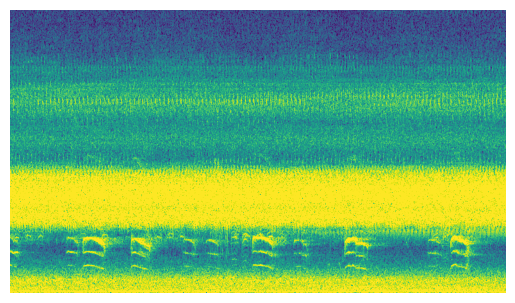

Blue Jay
0.7657403


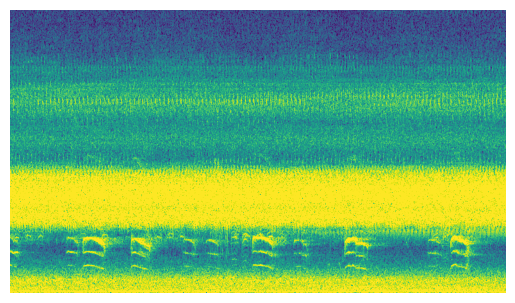

No detection
1.0


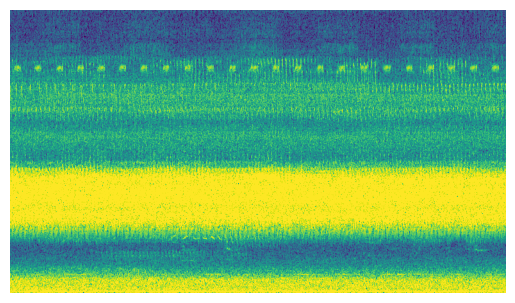

No detection
1.0


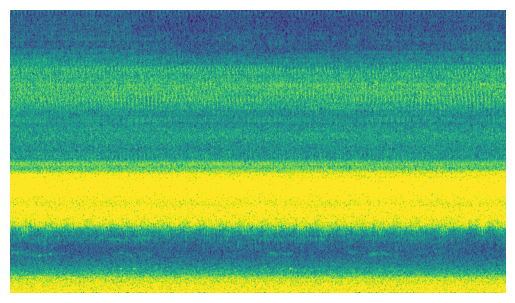

Blue Jay
0.7413759


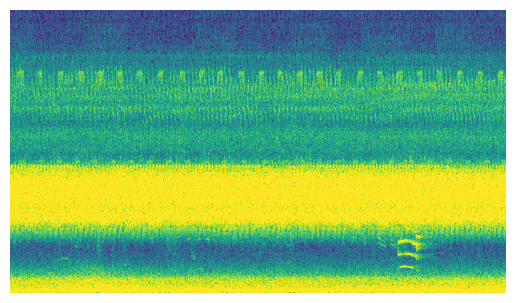

No detection
1.0


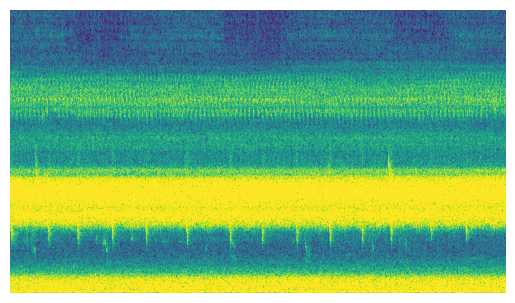

No detection
1.0


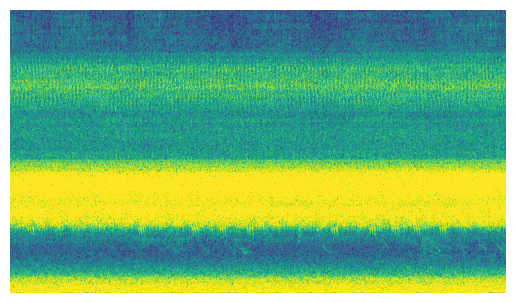

Blue Jay
0.4696932


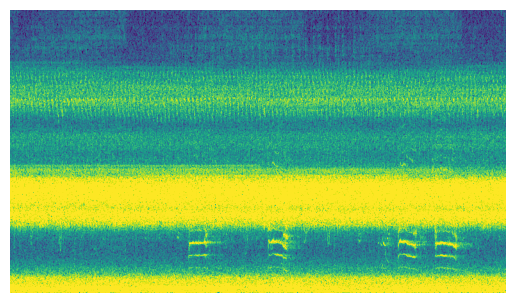

Red-breasted Nuthatch
0.10635011


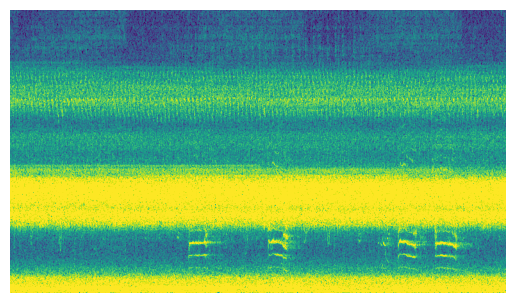

Blue Jay
0.42945904


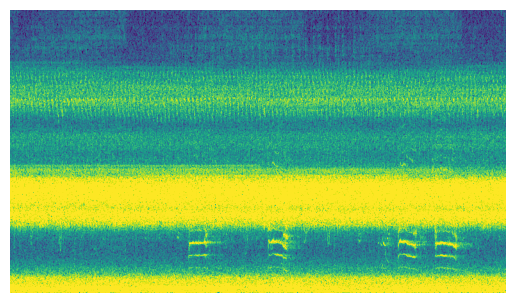

Red-breasted Nuthatch
0.23063585


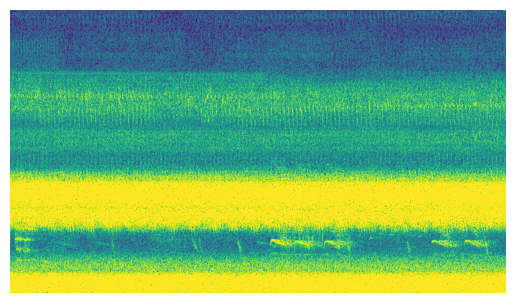

Black-capped Chickadee
0.105971724


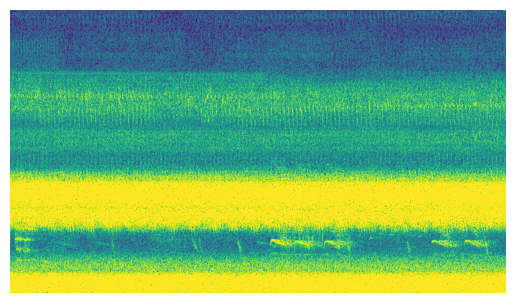

Philadelphia Vireo
0.23521508


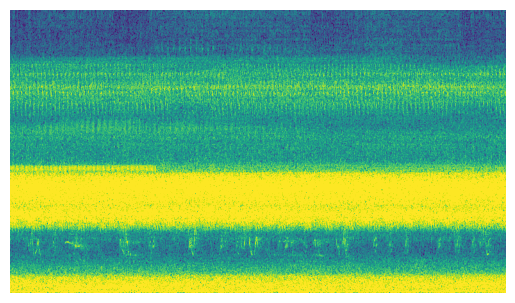

Red-eyed Vireo
0.10021035


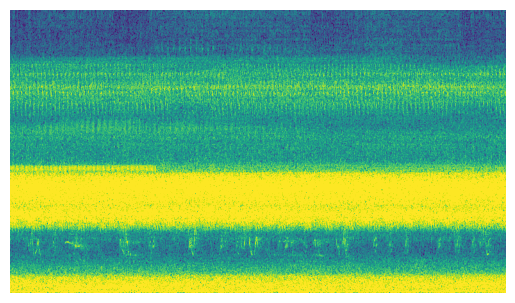

House Finch
0.3203971


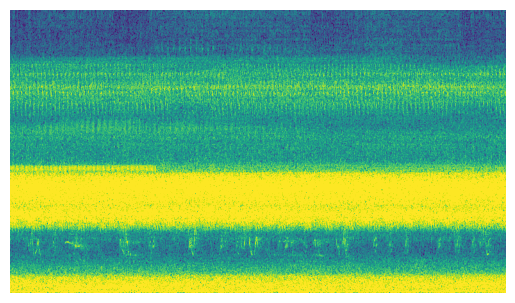

No detection
1.0


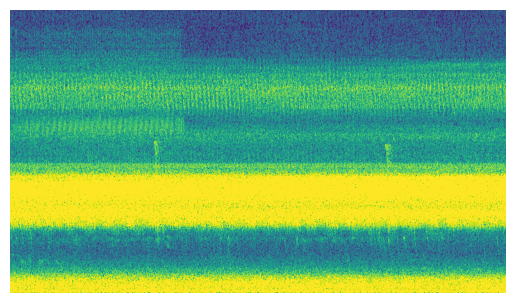

No detection
1.0


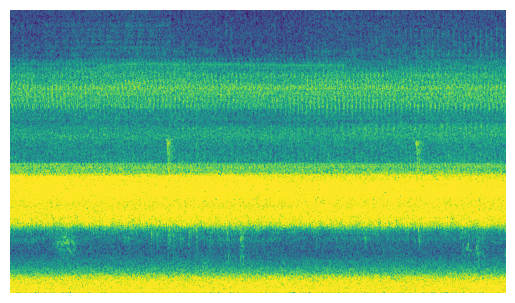

Common Grackle
0.2267184


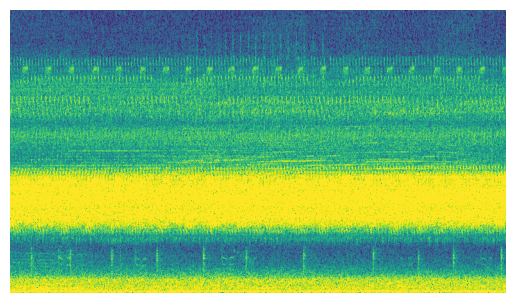

Common Grackle
0.12436975


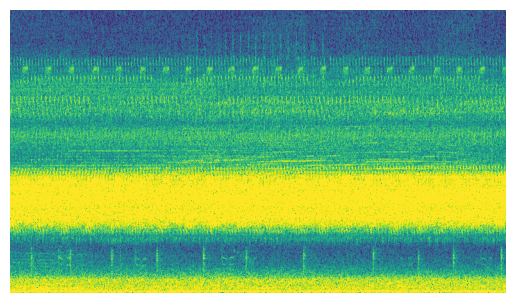

Common Grackle
0.2282353


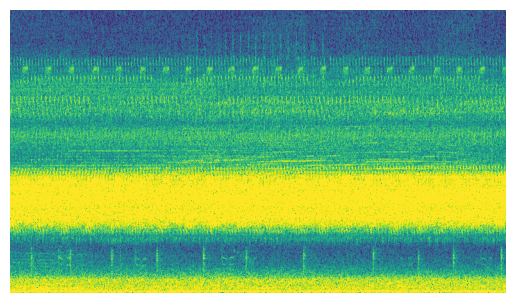

Blue Jay
0.3284227


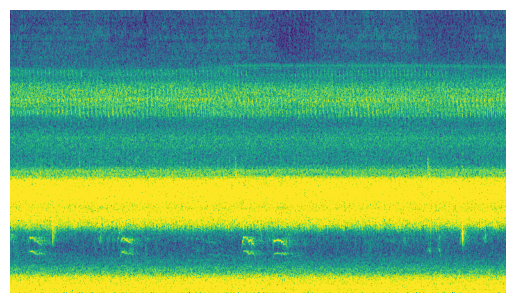

Gray Catbird
0.34447402


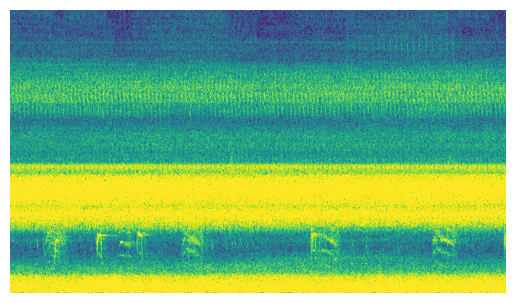

Gray Catbird
0.10419608


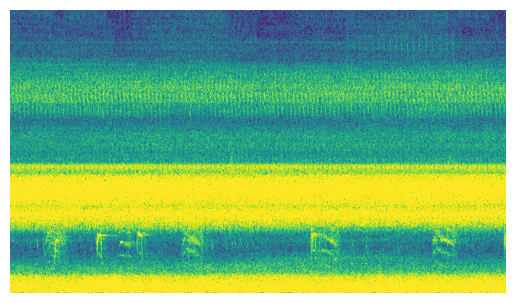

No detection
1.0


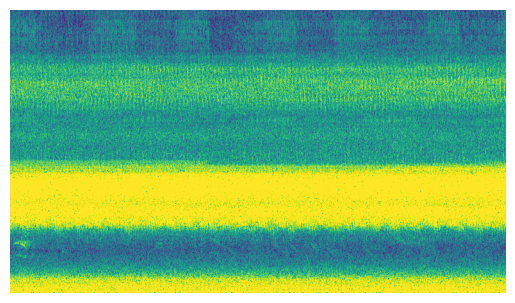

Blue Jay
0.9142886


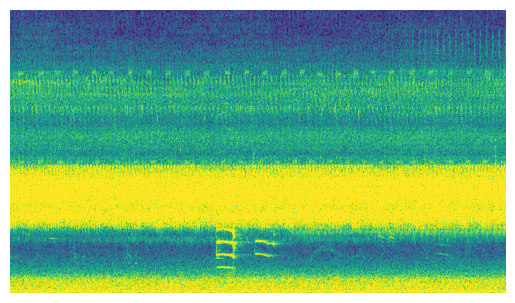

Red-winged Blackbird
0.114752956


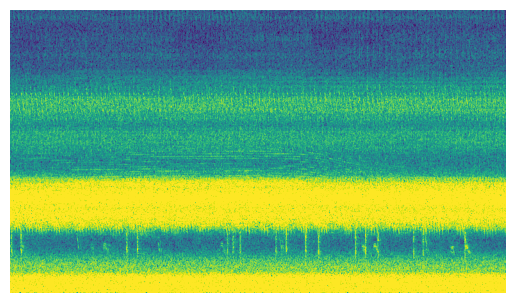

Blue Jay
0.6369132


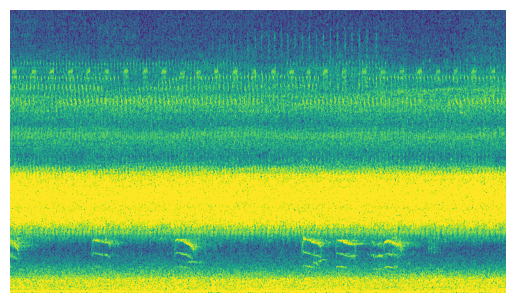

Blue Jay
0.7300525


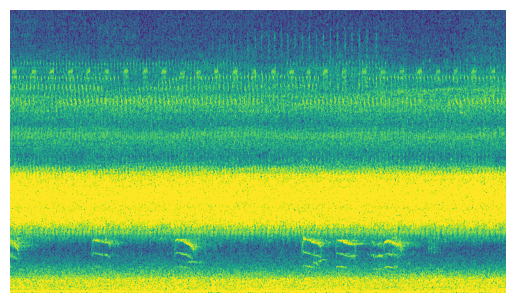

Blue Jay
0.15667275


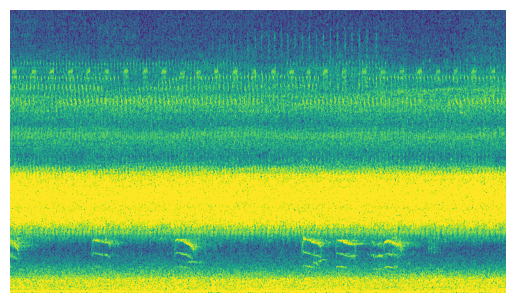

Red-breasted Nuthatch
0.24701273


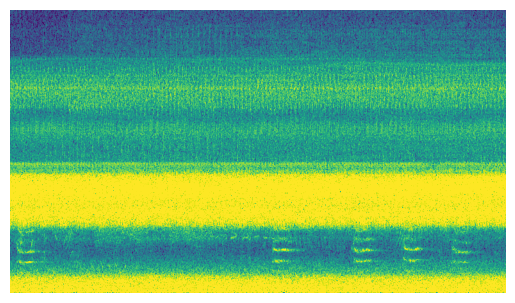

Blue Jay
0.11634218


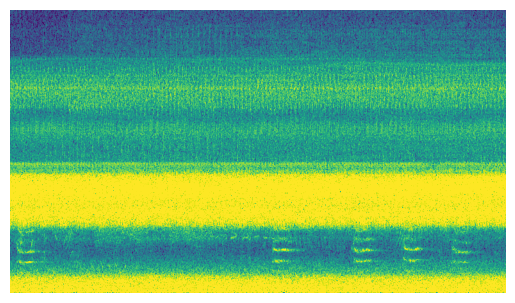

Blue Jay
0.5916629


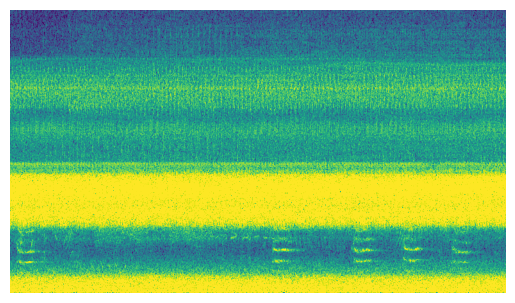

Blue Jay
0.1887351


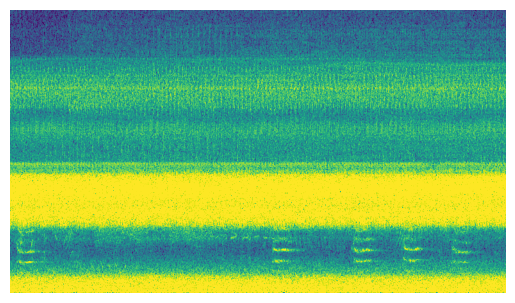

Eastern Bluebird
0.73138314


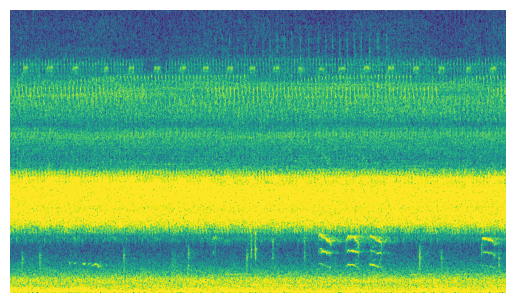

Blue Jay
0.50566286


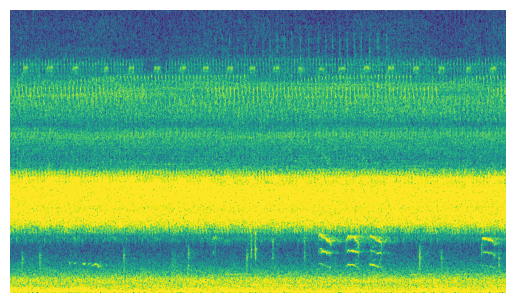

Chimney Swift
0.1360695


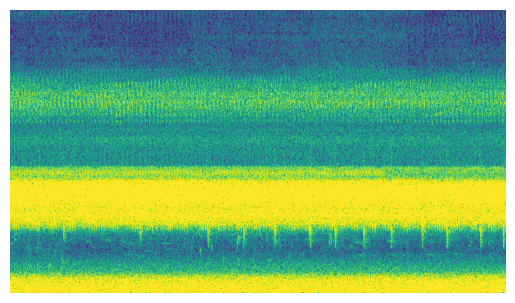

Blue Jay
0.12215747


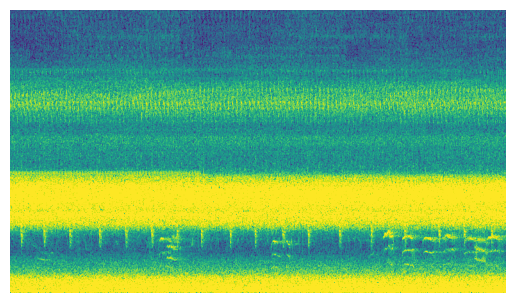

Chimney Swift
0.18163349


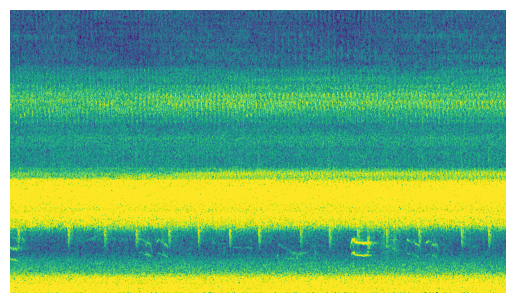

Blue Jay
0.24017832


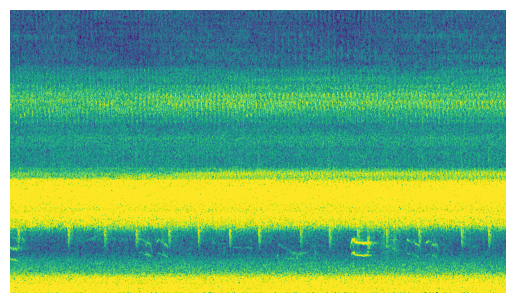

No detection
1.0


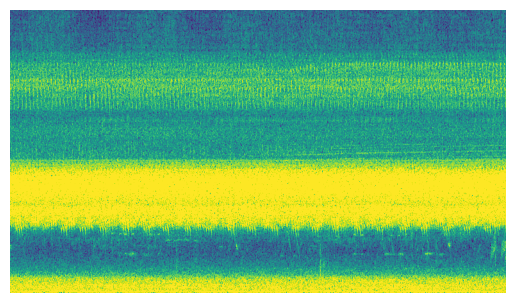

No detection
1.0


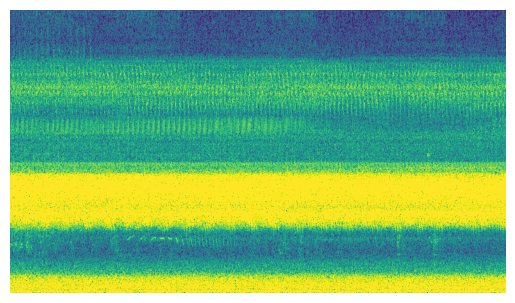

Blue Jay
0.10951202


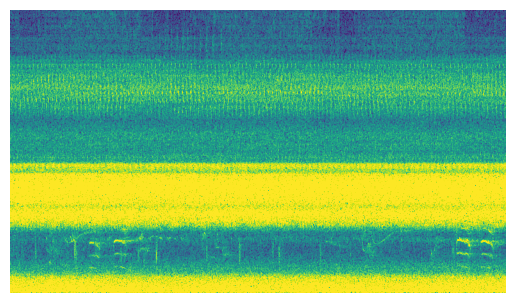

Field Sparrow
0.20871292


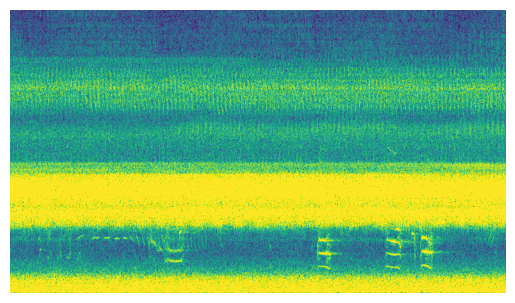

Blue Jay
0.7995238


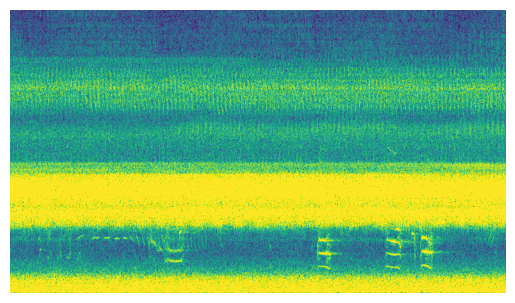

Blue Jay
0.41088337


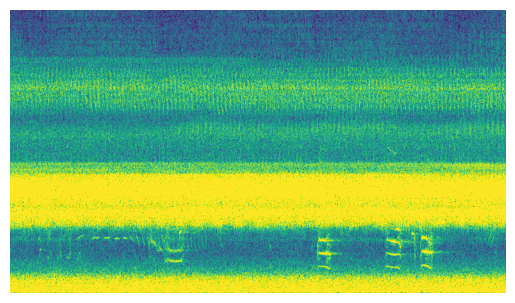

No detection
1.0


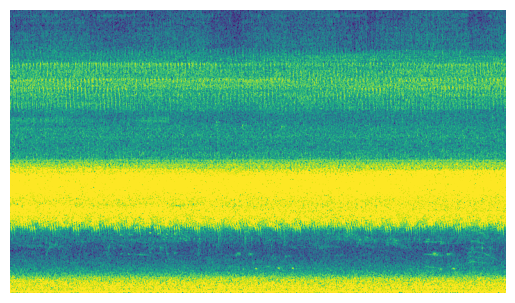

Gray Catbird
0.29522982


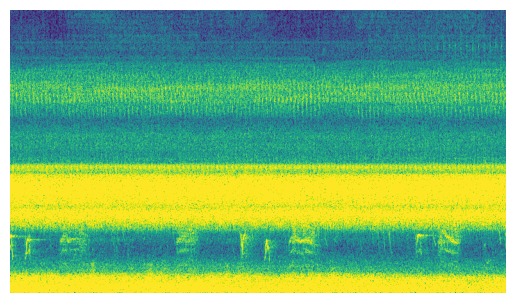

Blue Jay
0.25376886


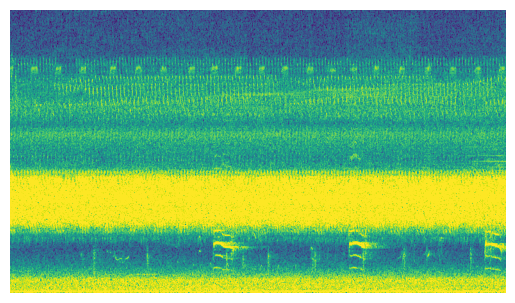

Blue Jay
0.8446946


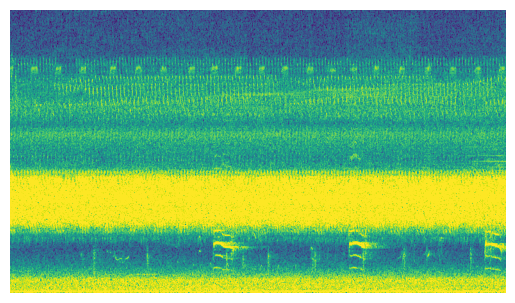

Red-eyed Vireo
0.25679955


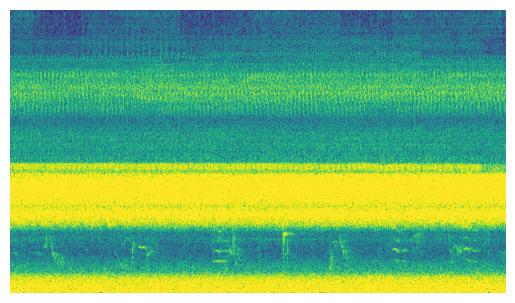

American Robin
0.1999107


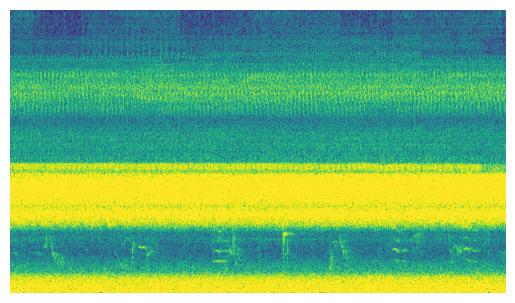

No detection
1.0


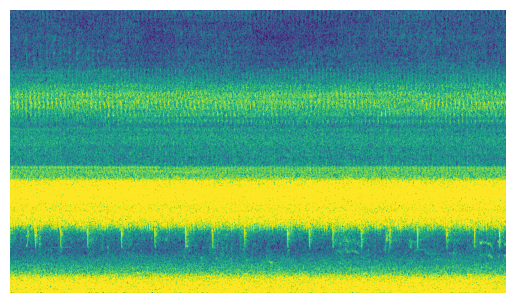

No detection
1.0


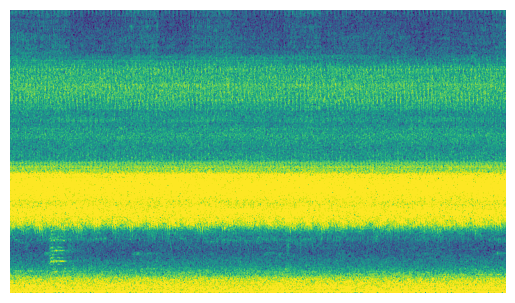

Blue Jay
0.5447424


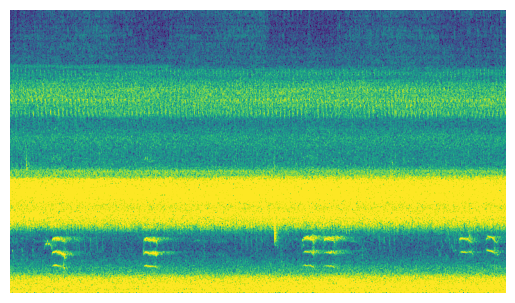

Blue Jay
0.15529206


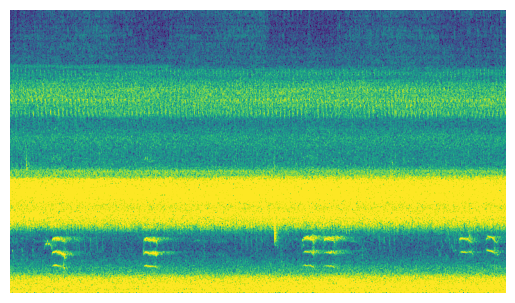

No detection
1.0


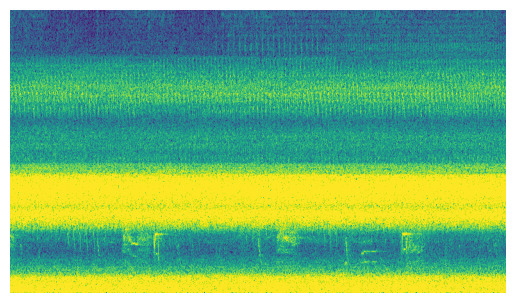

Common Grackle
0.20527202


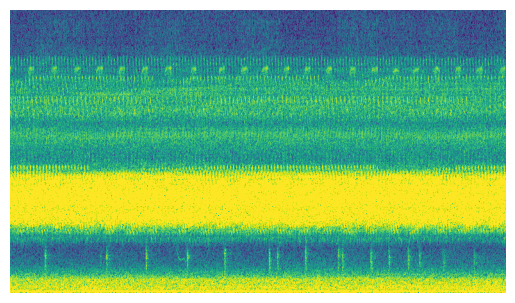

Common Grackle
0.28295144


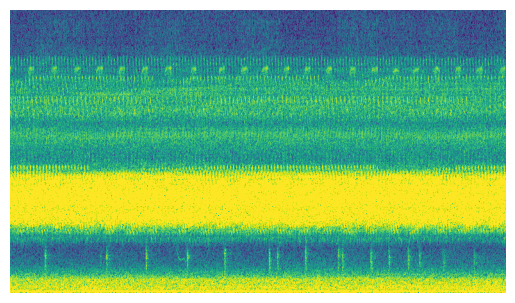

No detection
1.0


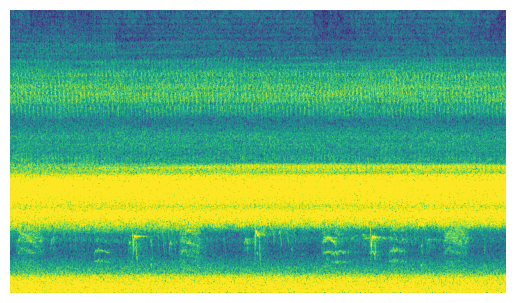

In [38]:
samples=df[df['labels']==cluster]
Spectrograms_BASE_PATH = '/grand/projects/BirdAudio/Soundscapes/First_Filtered_Spectrograms/'
Audio_BASE_PATH = '/grand/projects/BirdAudio/Soundscapes/Audio_Files/'
spectrogram_duration=9
for k, row in enumerate(samples.iterrows()):
    if k > 100:
        break
        
    file_path = row[1]['paths']
    print(row[1]['detection'])
    print(row[1]['confidence'])
    img = Image.open(os.path.join(Spectrograms_BASE_PATH, file_path))
    imgplot = plt.imshow(img)
    plt.axis('off')
    plt.show()
